In [1]:
import os
import colorsys
import numpy as np
import random
import pandas as pd
from scipy import stats
from collections import defaultdict

from scipy.spatial import cKDTree

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

import py3Dmol

from Bio.PDB import PDBIO, PDBParser, Select
from Bio.PDB.Chain import Chain
from Bio.PDB.Residue import Residue

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import pairwise_distances

## This notebook focuses on visualisation of PocketMiner predictions in 3D and residue clustering 

In [2]:
# dictionary to convert residue names to single letter
three_to_one_leter_name = {
                           "GLY": "G",
                           "ALA": "A",
                           "VAL": "V",
                           "LEU": "L",
                           "ILE": "I",
                           "SER": "S",
                           "THR": "T",
                           "MET": "M",
                           "CYS": "C",
                           "ASN": "N",
                           "GLN": "Q",
                           "ASP": "D",
                           "GLU": "E",
                           "LYS": "K",
                           "ARG": "R",
                           "HIS": "H", "HSD": "H", "HSE": "H", "HSP": "H",
                           "PHE": "F",
                           "TRP": "W",
                           "TYR": "Y",
                           "PRO": "P",
                           }

In [3]:
# list of the files for analysis
pdb_dirs = [x for x in os.listdir('.')]

files = []
for pdb_dir in pdb_dirs:
    if (not '.' in pdb_dir) and ('_' in pdb_dir):
        row = [pdb_dir, pdb_dir.split('_')[0].lower()]
        files.append(row)
files

[['7DDD_locked', '7ddd'],
 ['7K4N_up', '7k4n'],
 ['7KNI_up', '7kni'],
 ['6VXX_closed', '6vxx'],
 ['6ZP0_closed', '6zp0'],
 ['7KJ4_up', '7kj4'],
 ['6ZB5_locked', '6zb5'],
 ['7KSG_up', '7ksg'],
 ['7A98_up', '7a98'],
 ['6X29_closed', '6x29'],
 ['6ZGE_locked', '6zge'],
 ['6XR8_locked', '6xr8'],
 ['6X6P_closed', '6x6p'],
 ['6X2C_closed', '6x2c'],
 ['6ZB4_locked', '6zb4']]

In [4]:
# manually sort them
files = [
 ['7K4N_up', '7k4n'],
 ['7KNI_up', '7kni'],
 ['7KJ4_up', '7kj4'],
 ['7KSG_up', '7ksg'],
 ['7A98_up', '7a98'],
    
 ['6VXX_closed', '6vxx'],
 ['6ZP0_closed', '6zp0'],
 ['6X29_closed', '6x29'],
 ['6X6P_closed', '6x6p'],
 ['6X2C_closed', '6x2c'],
    
 ['6ZB5_locked', '6zb5'],
 ['6ZGE_locked', '6zge'],
 ['6XR8_locked', '6xr8'],
 ['6ZB4_locked', '6zb4'],
 ['7DDD_locked', '7ddd']
]

In [5]:
# read Spike sequence to compare
Spike_protein = ''
with open('S_protein.fasta', 'r') as f:
    for line in f:
        if not line.startswith('>'):
            Spike_protein += line.strip()
            
# convert into dictionary
Spike_protein_residues = {i+1:Spike_protein[i] for i in range(len(Spike_protein))}

**Load PocketMiner and fpocket data:**

In [7]:
# reload matrices
PocketMiner_df = pd.read_csv('data/PocketMiner_data.csv', index_col=0)
pocket_contact_df = pd.read_csv('data/fpocket_contact_data.csv', index_col=0)
pocket_contact_df = pocket_contact_df.loc[:, :].astype(int)
pocket_volume_df = pd.read_csv('data/fpocket_volume_data.csv', index_col=0)

PocketMiner_df.head()

,14,15,16,17,18,19,20,21,22,23,...,1153,1154,1155,1156,1157,1158,1159,1160,1161,1162
7K4N_up_A,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
7K4N_up_B,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
7K4N_up_E,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
7KNI_up_A,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
7KNI_up_B,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


<AxesSubplot:>

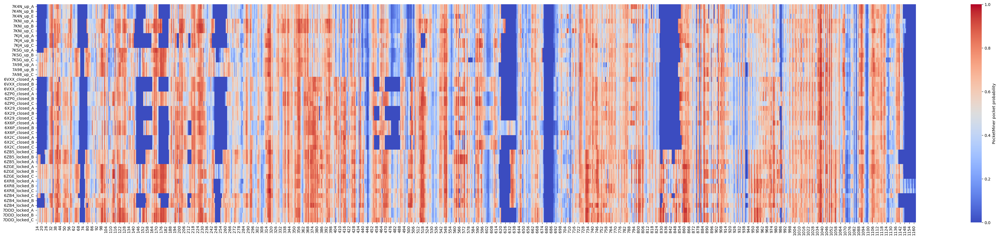

In [8]:
# quickly visualise the Pocket Miner matrix
plt.figure(figsize=(50, 10))
sns.heatmap(PocketMiner_df,
            vmin=0, vmax=1,
            cmap='coolwarm',
            cbar_kws={'label': 'PocketMiner pocket probability'})

## 1. Visualise PM prediction on protein structure

Spike protein structures are large so it may take a while to renmer them here. 
Alternatively, one can visualise the strcutres in PyMol using `vis_PocketMiner.py` script from this project.

In [9]:
# functions assisting in visualisation

def prob_to_color(prob):
    if prob > 0.5:
        rgb = colorsys.hsv_to_rgb(0, (2*prob) - 1, 1)
    else:
        rgb = colorsys.hsv_to_rgb(0.55, (2*(1 - prob)) - 1, 1)

    return {'r': rgb[0], 'g': rgb[1], 'b': rgb[2]}

def VisPocketMiner(file, res_to_focus=None,
                   prob_threshold=0.0, dim=(600,600)):
    
    # read system from PDB file
    with open(file,'r') as ifile:
        system = "".join([x for x in ifile])

    # generate view
    view = py3Dmol.view(width=dim[0], height=dim[1])
    view.addModelsAsFrames(system)
    view.setStyle({'model': -1}, {"cartoon": {'color': {'r': 0.95, 'g': 0.95, 'b': 0.95}}})
    
    # color each atom according to probability
    for i, line in enumerate(system.split("\n")):

        data = line.split()
        if len(data) == 0 or data[0] != "ATOM":
            continue

        prob = float(data[-2])
        res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
        
        if prob > prob_threshold:
            color = prob_to_color(prob)
            
            if (res_to_focus is None) or (res_id in res_to_focus):
                view.setStyle({'model': -1, 'serial': i + 1},
                              {"cartoon": {'color': color}})
            else:
                view.setStyle({'model': -1, 'serial': i + 1},
                              {"cartoon": {'color': {'r': 0.5, 'g': 0.5, 'b': 0.5}}})
                
    view.zoomTo()

    return view

In [10]:
# define wht structure to visualise
structure_to_visualise = '6VXX_closed'

file = f"{structure_to_visualise}/{structure_to_visualise.split('_')[0].lower()}_PocketMiner.pdb"

view = VisPocketMiner(file)
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

**Let's visualise only areas of conformational flexibilityidentifyed in [HDX-MS experiemnts](https://www.nature.com/articles/s41594-022-00735-5)**

In [11]:
residues_to_leave = [i for i in range(962, 1025)] + [i for i in range(1146, 1167)] + \
                    [i for i in range(1187, 1197)] + \
                    [i for i in range(870, 917)] + \
                    [i for i in range(553, 575)] + \
                    [i for i in range(662, 673)] + \
                    [i for i in range(291, 306)] + \
                    [i for i in range(626, 637)]

structure_to_visualise = '6VXX_closed'
file = f"{structure_to_visualise}/{structure_to_visualise.split('_')[0].lower()}_PocketMiner.pdb"

view = VisPocketMiner(file, residues_to_leave)
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

**Let's visualise residues from "explained" areas (HDX-MS residues + residues of 3 known cryptic pockets)**

In [12]:
# here we define the list of residues in MM, LA and PS pockets

MM_residues = """SER 316
ASN 317
PHE 318
ARG 319
VAL 320
GLN 321
PRO 322
THR 323
GLU 324
SER 591
PHE 592
GLY 593
GLY 594
VAL 595
SER 596
VAL 597
VAL 610
LEU 611
TYR 612
GLN 613
ASP 614
VAL 615
ASN 616
CYS 617
THR 618
GLU 619
VAL 620
PRO 621
VAL 622
ALA 623
ILE 624
HSD 625
ALA 626
ASP 627
GLN 628
ARG 646
ALA 647
GLY 648
CYS 649
LEU 650
ILE 651"""

MM_residues = MM_residues.split('\n')
MM_residues = [(int(el[-3:]), three_to_one_leter_name[el[:3]]) for el in MM_residues]
MM_residues.sort(key=lambda x: x[0])

# residues contacting with LA
# selected within 5Å threshold from LA in 7JJI structure
LA_residues = """LYS 417
GLY 416
GLN 409
THR 415
ARG 408
TYR 369
ALA 372
LEU 368
TYR 365
PHE 374
LEU 387
PHE 377
ILE 434
ALA 363
PHE 338
PHE 342
CYS 336
VAL 341
VAL 524
ILE 358
PHE 392
VAL 395
LEU 513
PHE 515"""

LA_residues = LA_residues.split('\n')
LA_residues = [(int(el[-3:]), three_to_one_leter_name[el[:3]]) for el in LA_residues]
LA_residues.sort(key=lambda x: x[0])

# residues contacting with PS
# selected within 5Å threshold from PS in 7JJI structure
PS_residues = """PHE 168
PRO 230
LEU 229
ASP 228
VAL 227
ILE 203
LEU 226
PHE 192
SER 205
HIS 207
ARG 190
GLU 96
ILE 101
ASN 99
TRP 104
GLY 103
ARG 102
ASN 121
PHE 175
ILE 119
VAL 126
SER 172
GLN 173
TYR 170
ILE 128"""

PS_residues = PS_residues.split('\n')
PS_residues = [(int(el[-3:]), three_to_one_leter_name[el[:3]]) for el in PS_residues]
PS_residues.sort(key=lambda x: x[0])

In [13]:
residues_to_leave = [i for i in range(962, 1025)] + [i for i in range(1146, 1167)] + \
                    [i for i in range(1187, 1197)] + \
                    [i for i in range(870, 917)] + \
                    [i for i in range(553, 575)] + \
                    [i for i in range(662, 673)] + \
                    [i for i in range(291, 306)] + \
                    [i for i in range(626, 637)]

# if specified like this we only take the residues 
# contacting the pocket ligands etc missing others
# explained_residues = set(residues_to_leave + \
#                      [el[0] for el in MM_residues] + \
#                      [el[0] for el in LA_residues] + \
#                      [el[0] for el in PS_residues])

# here we take broader range pf residues by including all RBD and NTD residues 
explained_residues = set(residues_to_leave + [el[0] for el in MM_residues] + [i for i in range(14, 306)] + [i for i in range(319, 542)]) #  NTD and RBD

# we need to exclude these bc of the different size of the structures
stem_residues = ['1163', '1164', '1165', '1166', '1187', '1188', '1189', '1190',
                 '1191', '1192', '1193', '1194', '1195', '1196']

explained_residues = [str(res) for res in explained_residues if not str(res) in stem_residues]

print(f"Selected {len(explained_residues)} residues with explained pocket/conformational mobility")

Selected 718 residues with explained pocket/conformational mobility


Let's colour explained areas in green, while the rest of the residues will be coloured by PM probability. Only one chain is highlighted for clarity

In [14]:
structure_to_visualise = '6VXX_closed'
file = f"{structure_to_visualise}/{structure_to_visualise.split('_')[0].lower()}_PocketMiner.pdb"
    
# read system from PDB file
with open(file,'r') as ifile:
    system = "".join([x for x in ifile])

# generate view
dim=(600,600)
view = py3Dmol.view(width=dim[0], height=dim[1])
view.addModelsAsFrames(system)
view.setStyle({'model': -1}, {"cartoon": {'color': {'r': 0.95, 'g': 0.95, 'b': 0.95}}})

# color each atom according to probability
for i, line in enumerate(system.split("\n")):

    data = line.split()
    if len(data) == 0 or data[0] != "ATOM":
        continue

    prob = float(data[-2])
    res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])

    color = prob_to_color(prob)

    if res_id > 1147:
        view.setStyle({'model': -1, 'serial': i + 1},
                      {"cartoon": {'color': {'r': 0.5, 'g': 0.5, 'b': 0.5}}})
    elif str(res_id) in explained_residues:
        view.setStyle({'model': -1, 'serial': i + 1},
                      {"cartoon": {'color': {'r': 0.0, 'g': 0.78, 'b': 0.21}}})
    else:
        view.setStyle({'model': -1, 'serial': i + 1},
                      {"cartoon": {'color': color}})
                
view.zoomTo()
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

## 2. Smooth out PocketMiner probabilities

This experiment was an attempt to smooth the residue probabilities by averaging the probabilities between nearby residues and see how it influences visualisation. The idea was that it may highlight the areas of interest

In [252]:
distance_threshold = 3 #Å to group residues for smoothing

input_structure = '6VXX_closed'
pdb_id = input_structure.split('_')[0].lower()

# read probabilities for each residue in structure
PM_probabilities = {}
with open(f"{input_structure}/{pdb_id}_PocketMiner.pdb", 'r') as f:
    lines = f.readlines()
for line in lines:
    if "ATOM" in line:
        data = line.split()
        res_prob = float(data[-2])
        res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
        PM_probabilities[res_id] = res_prob

# for each residue pcik rersidues within distance threshold
# and calculate new probability by averaging
print('Selecting nearby residues for each reasidue...')
parser = PDBParser()
trimer_structure = parser.get_structure('trimer',
                                        f"{input_structure}/{pdb_id}_PocketMiner.pdb")

# get atoms and coordinates from the structure
atoms = [a for a in trimer_structure.get_atoms()]
atoms_coords = np.array([a.get_coord() for a in atoms])

a_tree = cKDTree(atoms_coords)
b_tree = cKDTree(atoms_coords)

# compute distances with a cut-off
dist = a_tree.sparse_distance_matrix(b_tree, max_distance = distance_threshold)
dist = dist.toarray()

# iterate over aroms in structure
cur_residue = atoms[0].get_parent().id[1] # currently proccessed residue
cur_close_residues = set() # set of close residues
close_residues_dict = {}
for i in range(dist.shape[0]):
    
    # parent residue of current atoms
    this_residue = atoms[i].get_parent().id[1]
    
    if this_residue != cur_residue:
        # finished processing the residue, finalise its data
        close_residues_dict[cur_residue] = list(cur_close_residues)
        cur_residue = atoms[i].get_parent().id[1]
        cur_close_residues = set()
        
    close_atoms_indices = dist[i, :].nonzero()[0]
    # check residues of closer atoms
    for ind in close_atoms_indices:
        res = atoms[ind].get_parent().id[1]
        if res != cur_residue:
            cur_close_residues.add(res)
            
# and the final residue
close_residues_dict[cur_residue] = list(cur_close_residues)
print('Finished...')

# average probabilities
PM_averaged_probabilities = {}
for res_id in close_residues_dict:
    probs = [PM_probabilities[res_id]]
    for ind in close_residues_dict[res_id]:
        probs.append(PM_probabilities[ind])
    PM_averaged_probabilities[res_id] = sum(probs) / len(probs)

# write new file with updated probabilities
with open(f"{input_structure}/{pdb_id}_PocketMiner_smoothed_{distance_threshold}.pdb", 'w') as f:
    for line in lines:
        if "ATOM" in line:
            data = line.split()
            res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
            new_line = line[:62] + \
                       str(round(PM_averaged_probabilities[res_id], 2)) + \
                       line[66:]
        else:
            new_line = line
        f.write(new_line)

Selecting nearby residues for each reasidue...
Finished...


In [15]:
structure_to_visualise = '6VXX_closed'
file = f"{structure_to_visualise}/{structure_to_visualise.split('_')[0].lower()}_PocketMiner_smoothed_3.pdb"

view = VisPocketMiner(file)
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

Regardless of selected distance threshold, this approach is not helpful. High probabilities are lowered, while low probabilities are elevated. As a result we rather loose contrast then emphasise the differences.

## 3. Density-based clustering

Here we employ DBSCAN algorithm with Euclidean distance metric modifyed to account for PM probabilities of the residues. The aim is to group most dense aggregations of residues with highest probabilities as prioritised locations of potential cryptic pocket opening.

In [16]:
# Euclidian distance modifyed to account for probabilities 
def EuclideanWeighted(x, y):
    p = 1 / (x[-1] + y[-1])**2
    d = np.sqrt(sum((x[:-1] - y[:-1])**2))
    return  p * d

# function to load data on residues
def LoadResidueData(files, prob_threshold = 0.8):

    # we will collect data here
    data_for_PCA = {}

    # read residue coordinates with probabilities
    residues = defaultdict(list)
    residues_properties = {}
    with open(file, 'r') as f:
        for line in f:
            if "ATOM" in line:
                data = line.split()

                res_prob = float(data[-2])
                coords = [float(data[-6]), float(data[-5]), float(data[-4])]
                res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])

                if res_prob > prob_threshold:
                    residues[res_id].append(coords)
                    residues_properties[res_id] = res_prob

    # calculate centroids for each residue
    for res_id in residues:
        residues[res_id] = np.array(residues[res_id]).mean(axis=0)

    # create data matrix 
    matrix = []
    for res_id in residues:
        new_row = list(residues[res_id])
        new_row.append(residues_properties[res_id])
        matrix.append(new_row)

    res_ids   = [i for i in residues] 
    res_probs = [residues_properties[i] for i in residues]

    data_for_PCA = {
        'data' : np.array(matrix),
        'labels' : res_ids,
        'probs' : res_probs
    }

    return data_for_PCA

# load atom indicies for each residue
def load_atoms_per_residue(file):
    
    res_atoms = defaultdict(list)
    
    atom_ind = 1
    with open(file, 'r') as f:
        for line in f:
            if "ATOM" in line:
                data = line.split()
                res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                res_atoms[res_id].append(atom_ind)
                atom_ind += 1
    
    return res_atoms

# visualise clusers on structure
def VisClusters(file, clusters, atoms_per_res, dim=(500,500)):
    
    # read system from PDB file
    with open(file,'r') as ifile:
        system = "".join([x for x in ifile])

    # generate view
    view = py3Dmol.view(width=dim[0], height=dim[1])
    view.addModelsAsFrames(system)
    view.setStyle({'model': -1}, {"cartoon": {'color': {'r': 0.9, 'g': 0.9, 'b': 0.9}}})
    
    # generate colors for each cluster
    colors =  sns.color_palette(None, len(clusters))         
    
    # color each atom according to probability
    for color, lab in zip(colors, clusters.keys()):
        r, g, b = color
        # color each atom in each residue belonging to the cluster
        for res in clusters[lab]:
            for i in atoms_per_res[res]:
                view.setStyle({'model': -1, 'serial': i},
                              {"cartoon": {'color': {'r': r, 'g': g, 'b': b}}})

    view.zoomTo()

    return view

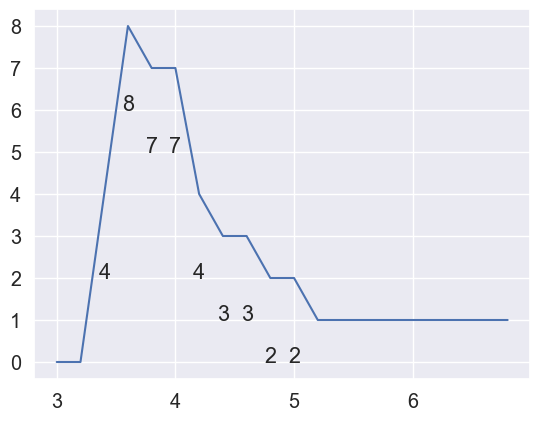

In [163]:
structure_to_visualise = '6VXX_closed'
file = f"{structure_to_visualise}/{structure_to_visualise.split('_')[0].lower()}_PocketMiner.pdb"

# load PM data for clustering
residue_data = LoadResidueData(file,
                               prob_threshold=0.5)

# epsilons for min sample 20 and squared prob normaliser
epsilons = np.arange(3.0, 7.0, 0.2)

results, lab_count_list = [], []
for epsilon in epsilons:
    
    clusterer = DBSCAN(eps=epsilon,
                       min_samples=20,
                       metric=EuclideanWeighted)

    clusterer.fit(residue_data['data'])

    labels = clusterer.labels_
    
    no_clusters = len(np.unique(labels)) - 1 # we dont count noise labels
    no_noise = np.sum(np.array(labels) == -1, axis=0)
    
    # count number of residues in each cluster
    labs = np.unique(labels)
    lab_counts = []
    for lab in labs:
        if lab != -1:
            lab_counts.append(np.count_nonzero(labels == lab))
    
    results.append([no_clusters, no_noise])
    lab_count_list.append(lab_counts)
    
results = np.array(results)

fig, ax = plt.subplots()
ax.plot(epsilons, results[:, 0])

for i, txt in enumerate(results[:, 0]):
    ax.annotate(txt, (epsilons[i]-0.05, results[:, 0][i]-2))

In [ ]:
####### visualise #########

# cluster 
clusterer = DBSCAN(eps=3.8,
                   min_samples=20,
                   metric=EuclideanWeighted)

clusterer.fit(residue_data['data'])
labels = clusterer.labels_ # get labels for each point
unique_labs = np.unique(labels)[1:] # get labels without the noise points
print(f"Discovered {len(unique_labs)} clusters")

# get residue indices for each cluster
res_inds = np.array(residue_data['labels'])
clusters = {}
for lab in unique_labs:
    mask = (labels == lab)
    clusters[lab] = res_inds[mask]
    
atoms_per_res = load_atoms_per_residue(file)

view =  VisClusters(file, clusters, atoms_per_res)
view.show() 

## 4. Create protein structures with randomised sequences

Lets take Spike protein backbone and create a structures with some other residue sidechains to see how it would alter PocketMiner predictions

In [18]:
res_list = set('GALMFWKQESPVICYHRNDT')
files_for_decoys = [['7KNI_up', '7kni'],
                    ['6VXX_closed', '6vxx'],
                    ['6ZGE_locked', '6zge']]

In [32]:
for file, pdb_id in files_for_decoys:
    
    # open the structure file and read chain sequences
    sequence = ''
    residues = []
    with open(f'{file}/{pdb_id}_renumbered_chains_A.pdb', 'r') as f:
        for line in f:
            if "ATOM" in line:
                data = line.split()
                res_name = three_to_one_leter_name[data[3]]
                res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                if not res_id in residues:
                    sequence += res_name
                    residues.append(res_id)
       
    chain_break = len(sequence) // 3
    chain_seq = sequence[:chain_break]

    # generate 3 decoys
    os.makedirs(f'{file}/decoys', exist_ok=True)
    with open(f'{file}/decoys/decoys.fasta', 'w') as f:
        for i in range(1, 4):

            # randomise each residue in chain
            new_seq = ''
            for res in chain_seq:
                new_seq += random.choice(list(res_list - set(res)))
            
            f.write(f'>decoy_{i}\n')
            f.write(f'{new_seq*3}\n')

Using decoys sequences generated the structures with random seqiences using the structures with renumbered residues and chains renamed to A. Generated with https://zhanggroup.org/FASPR/. Performed predictions with PM for decoys. Now lets plot:

In [38]:
threshold = 0.5

PM_for_structures = []
PM_for_decoys     = []
for file, pdb_id in files_for_decoys:
    
    # read PM data from file
    probs, residues = [], []
    with open(f'{file}/{pdb_id}_PocketMiner.pdb', 'r') as f:
        for line in f:
            if "ATOM" in line:
                data = line.split()
                res_prob = float(data[-2])
                res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                if not res_id in residues:
                    probs.append(res_prob)
                    residues.append(res_id)
    probs = np.array(probs)
    PM_for_structures.append(np.sum(probs >= threshold) / len(probs))
    
    # read PM data from decoys
    row = []
    for i in range(1, 4):
        
        probs, residues = [], []
        with open(f'{file}/decoys/decoy_{i}_PocketMiner.pdb', 'r') as f:
            for line in f:
                if "ATOM" in line:
                    data = line.split()
                    res_prob = float(data[-2])
                    res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                    if not res_id in residues:
                        probs.append(res_prob)
                        residues.append(res_id)
                        
        probs = np.array(probs)
        row.append(np.sum(probs >= threshold) / len(probs))
    PM_for_decoys.append(row)
    
PM_for_decoys = np.array(PM_for_decoys)
PM_for_structures = np.array(PM_for_structures)

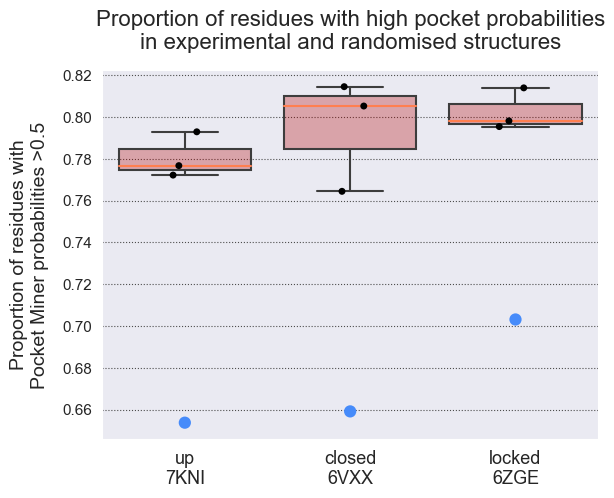

In [41]:
# generate plot

# box plots for decoys
sns.set_style("darkgrid", {"grid.color": ".3", 
                           "grid.linestyle": ":"})

ax = sns.boxplot(data = PM_for_decoys.T,
                 boxprops={"facecolor": (.7, .0, .0, .3)},
                 medianprops={"color": "coral"})

sns.stripplot(data=PM_for_decoys.T, ax=ax, color='black')

sns.pointplot(x = ['up\n7KNI', 'closed\n6VXX', 'locked\n6ZGE'],
              y = PM_for_structures,
              join=False, color='#468bfa')

ax.set_xticklabels(['up\n7KNI', 'closed\n6VXX', 'locked\n6ZGE'], fontsize = 13)
ax.tick_params(axis='y', labelsize=11)
ax.set_title("Proportion of residues with high pocket probabilities\nin experimental and randomised structures",
             fontsize = 16, pad=15)
ax.set_ylabel("Proportion of residues with\nPocket Miner probabilities >0.5",
              fontsize = 14, labelpad=10)

# plt.savefig('decoys_vs_structures.png', dpi=300, bbox_inches='tight')
plt.show()

In [19]:
# print commands for proportion difference testing in R
threshold = 0.5

PM_for_structures = []
PM_for_decoys     = []
for file, pdb_id in files_for_decoys:
    
    # read PM data from file
    probs, residues = [], []
    with open(f'{file}/{pdb_id}_PocketMiner.pdb', 'r') as f:
        for line in f:
            if "ATOM" in line:
                data = line.split()
                res_prob = float(data[-2])
                res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                if not res_id in residues:
                    probs.append(res_prob)
                    residues.append(res_id)
    probs = np.array(probs)
    PM_for_structures.append((np.sum(probs >= threshold), len(probs)))
    
    # read PM data from decoys
    row = []
    for i in range(1, 4):
        
        probs, residues = [], []
        with open(f'{file}/decoys/decoy_{i}_PocketMiner.pdb', 'r') as f:
            for line in f:
                if "ATOM" in line:
                    data = line.split()
                    res_prob = float(data[-2])
                    res_id = int(data[5]) if len(data[4]) == 1 else int(data[4][1:])
                    if not res_id in residues:
                        probs.append(res_prob)
                        residues.append(res_id)
                        
        probs = np.array(probs)
        row.append((np.sum(probs >= threshold), len(probs)))
    PM_for_decoys.append(row)
    
PM_for_decoys = np.array(PM_for_decoys)
PM_for_structures = np.array(PM_for_structures)

for i in range(3):
    sample = PM_for_decoys[i, :].sum(axis=0)
    print(f"prop.test(c({PM_for_structures[i, 0]}, {sample[0]}), c({PM_for_structures[i, 1]}, {sample[1]}))")

prop.test(c(2020, 7236), c(3090, 9270))
prop.test(c(1922, 6952), c(2916, 8748))
prop.test(c(2316, 7930), c(3294, 9882))
